<a href="https://colab.research.google.com/github/nislambd/D7041E/blob/main/Lab4/D7041E_lab4_SOM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# D7041E Applied Artificial Intelligence
## LAB-4: Unsupervised learning with Self-Organized Maps
Submitted by: Srinivas Bobba and Nazrul Islam ( Group-6)

#### Import Required libraries

In [ ]:
import numpy as np
import numpy.matlib
from matplotlib import pyplot as plt
from keras.datasets import mnist
import math
import time

###1: Load MNIST data & 2: Load and Used the flattened (that is 1D) array of pixels of each image as a feature vector

In [ ]:
#Load and Used the flattened (that is 1D) array of pixels of each image as a feature vector

n_samples = 100

(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

train_images = train_images[:n_samples]
train_labels = train_labels[:n_samples]

test_images = test_images[:n_samples]
test_labels = test_labels[:n_samples]

# Flatten the images
train_images_flattened = train_images.reshape(train_images.shape[0], -1) /255.0
test_images_flattened = test_images.reshape(test_images.shape[0], -1) / 255.0

11490434/11490434 [==============================] - 1s 0us/step


In [ ]:
def getEuclideanDistance(single_point,array):
    nrows, ncols, nfeatures=array.shape[0],array.shape[1], array.shape[2]
    points=array.reshape((nrows*ncols,nfeatures))

    dist = (points - single_point)**2
    dist = np.sum(dist, axis=1)
    dist = np.sqrt(dist)

    dist=dist.reshape((nrows,ncols))
    return dist

In [ ]:
mu, sigma = 0, 0.1
A = np.random.normal(mu, sigma, 10)
#A.shape, A

In [ ]:
nrows,ncols,nfeatures=3,3,3

#Generate coordinate system
x,y=np.meshgrid(range(ncols),range(nrows))

In [ ]:
sgm0=2
sgmdecay=0.05
t=1
sgm = sgm0 * math.exp(-t*sgmdecay);

width = math.ceil(sgm*3)

dist=np.array([[2,1,3],[3,2,3],[4,4,4]])
bmurow, bmucol =np.unravel_index(np.argmin(dist, axis=None), dist.shape)

g = np.exp(-((np.power(x - bmucol,2)) + (np.power(y - bmurow,2))) / (2*sgm*sgm));


fromrow = max(0,bmurow - width);
torow   = min(bmurow + width,nrows);
fromcol = max(0,bmucol - width);
tocol   = min(bmucol + width,ncols);

In [ ]:
G = np.dstack([g[fromrow:torow,fromcol:tocol]]*nfeatures);

In [ ]:
# Visualization
def visualize_som(som, nrows, ncols, dispRes, message):
    print("\n" + message + "\n")
    fig, ax = plt.subplots(nrows=nrows, ncols=ncols, figsize=(15,15))
    for k in range(nrows):
        for l in range(ncols):
            A = som[k, l, :].reshape(dispRes)
            ax[k, l].imshow(A, cmap="plasma")
            ax[k, l].set_yticks([])
            ax[k, l].set_xticks([])
    plt.show()

In [ ]:
def SOM (dispRes, trainingData, ndim=10, nepochs=10, eta0=0.1, etadecay=0.05, sgm0=20, sgmdecay=0.05, showMode=0):
    nfeatures=trainingData.shape[1]
    ntrainingvectors=trainingData.shape[0]

    nrows = dispRes[0] #ndim
    ncols = dispRes[1] #ndim

    mu, sigma = 0, 0.1
    numpy.random.seed(int(time.time()))
    som = np.random.normal(mu, sigma, (nrows,ncols,nfeatures))

    if showMode >= 1:
        print("\nSOM features before training: \n")

        fig, ax=plt.subplots(nrows=nrows, ncols=ncols, figsize=(15,15))

        for k in range(nrows):
            for l in range (ncols):
                A=som[k,l,:].reshape((dispRes[0],dispRes[1]))
                ax[k,l].imshow(A,cmap="plasma")
                ax[k,l].set_yticks([])
                ax[k,l].set_xticks([])

    #Generate coordinate system
    x,y=np.meshgrid(range(ncols),range(nrows))

    if showMode>=1:
        #Added visualazation on the SOM weights at start when showmode => 1
        visualize_som(som, nrows,ncols,dispRes, 'at the Beginning')

    for t in range (1,nepochs+1):
        #Compute the learning rate for the current epoch
        eta = eta0 * math.exp(-t*etadecay);

        #Compute the variance of the Gaussian (Neighbourhood) function for the ucrrent epoch
        sgm = sgm0 * math.exp(-t*sgmdecay);

        #Consider the width of the Gaussian function as 3 sigma
        width = math.ceil(sgm*3);

        for ntraining in range(ntrainingvectors):
            trainingVector = trainingData[ntraining,:];

            # Compute the Euclidean distance between the training vector and
            # each neuron in the SOM map
            dist = getEuclideanDistance(trainingVector, som);

            # Find 2D coordinates of the Best Matching Unit (bmu)
            bmurow, bmucol =np.unravel_index(np.argmin(dist, axis=None), dist.shape) ;


            #Generate a Gaussian function centered on the location of the bmu
            g = np.exp(-((np.power(x - bmucol,2)) + (np.power(y - bmurow,2))) / (2*sgm*sgm));

            #Determine the boundary of the local neighbourhood
            fromrow = max(0,bmurow - width);
            torow   = min(bmurow + width,nrows);
            fromcol = max(0,bmucol - width);
            tocol   = min(bmucol + width,ncols);


            #Get the neighbouring neurons and determine the size of the neighbourhood
            neighbourNeurons = som[fromrow:torow,fromcol:tocol,:];
            sz = neighbourNeurons.shape;

            #Transform the training vector and the Gaussian function into
            # multi-dimensional to facilitate the computation of the neuron weights update
            T = np.matlib.repmat(trainingVector,sz[0]*sz[1],1).reshape((sz[0],sz[1],nfeatures));
            G = np.dstack([g[fromrow:torow,fromcol:tocol]]*nfeatures);

            # Update the weights of the neurons that are in the neighbourhood of the bmu
            neighbourNeurons = neighbourNeurons + eta * G * (T - neighbourNeurons);


            #Put the new weights of the BMU neighbouring neurons back to the
            #entire SOM map
            som[fromrow:torow,fromcol:tocol,:] = neighbourNeurons;

        if t == nepochs // 2:
            if showMode>=1:
                #Added visualazation on the SOM weights at half way when showmode => 1
                visualize_som(som, nrows,ncols,dispRes, 'Halfway Through')

    if showMode>=1:
        #Added visualazation on the SOM weights at end when showmode => 1
        visualize_som(som, nrows,ncols,dispRes, 'at the End')

    if showMode >= 1:
        print("\nSOM features AFTER training: \n")

        fig, ax=plt.subplots(nrows=nrows, ncols=ncols, figsize=(15,15))

        for k in range(nrows):
            for l in range (ncols):
                A=som[k,l,:].reshape((dispRes[0],dispRes[1]))
                ax[k,l].imshow(A,cmap="plasma")
                ax[k,l].set_yticks([])
            ax[k,l].set_xticks([])
    return som


In [ ]:
import pandas as pd
def parse_input_zoo_data(filename, header='infer'):

    input_data = pd.read_csv(filename, header=header)

    classes = input_data[17].tolist()
    labels = input_data[0].tolist()
    input_database = {
        0: input_data[[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16]].to_numpy()
    }

    return input_database, labels, classes

In [ ]:
input_filename = 'zoo.txt'
input_vector_database, labels, classes = parse_input_zoo_data(input_filename,None)

In [ ]:
#som_trained=SOM ([4,4],input_vector_database[0], ndim=10, nepochs=epoch, eta0=0.01, etadecay=0.05, sgm0=20, sgmdecay=0.05, showMode=1)
#plt.show()

### **3:** Train SOM with grid 20x20, 40x40, 80x80 grid_sizes = [20, 40, 80] & **4.** Display the initial, intermediate (at 50% of iterations) and the final learned weights of SOM neurons as a grid of 28x28 images


SOM features before training: 


at the Beginning



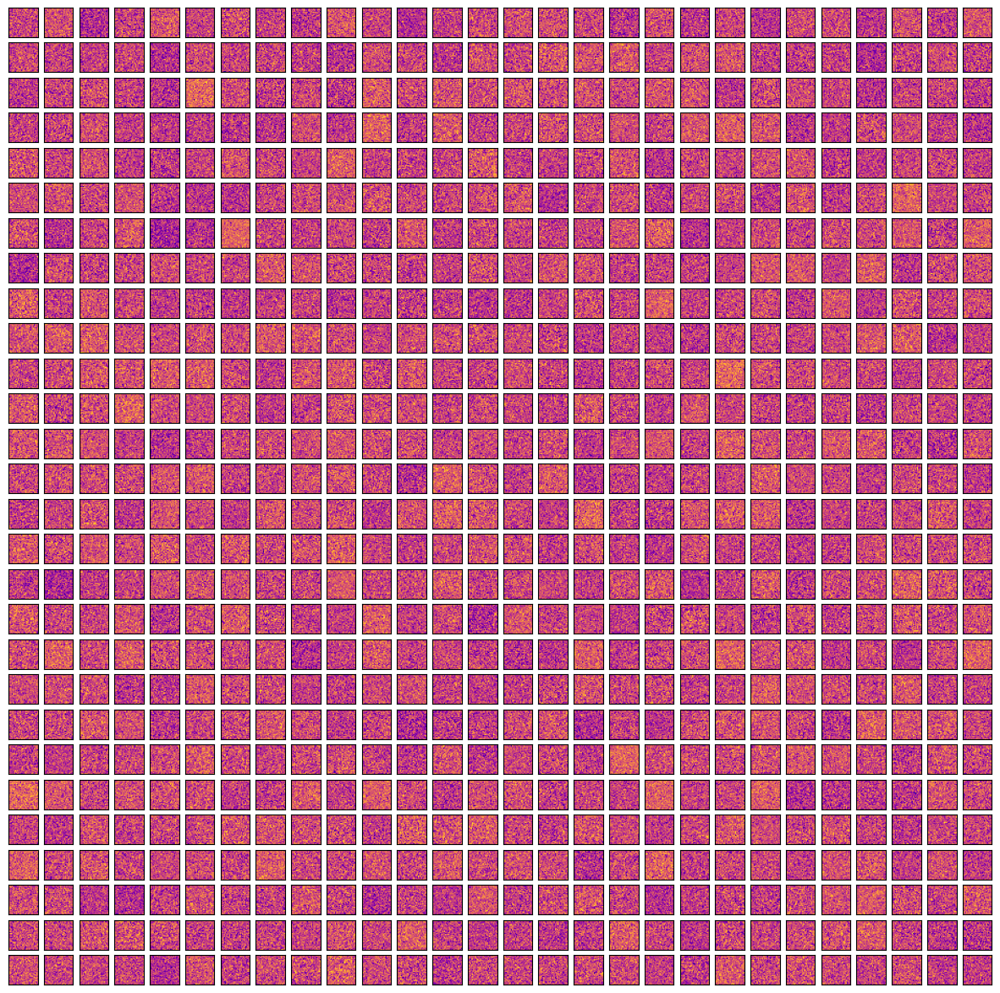

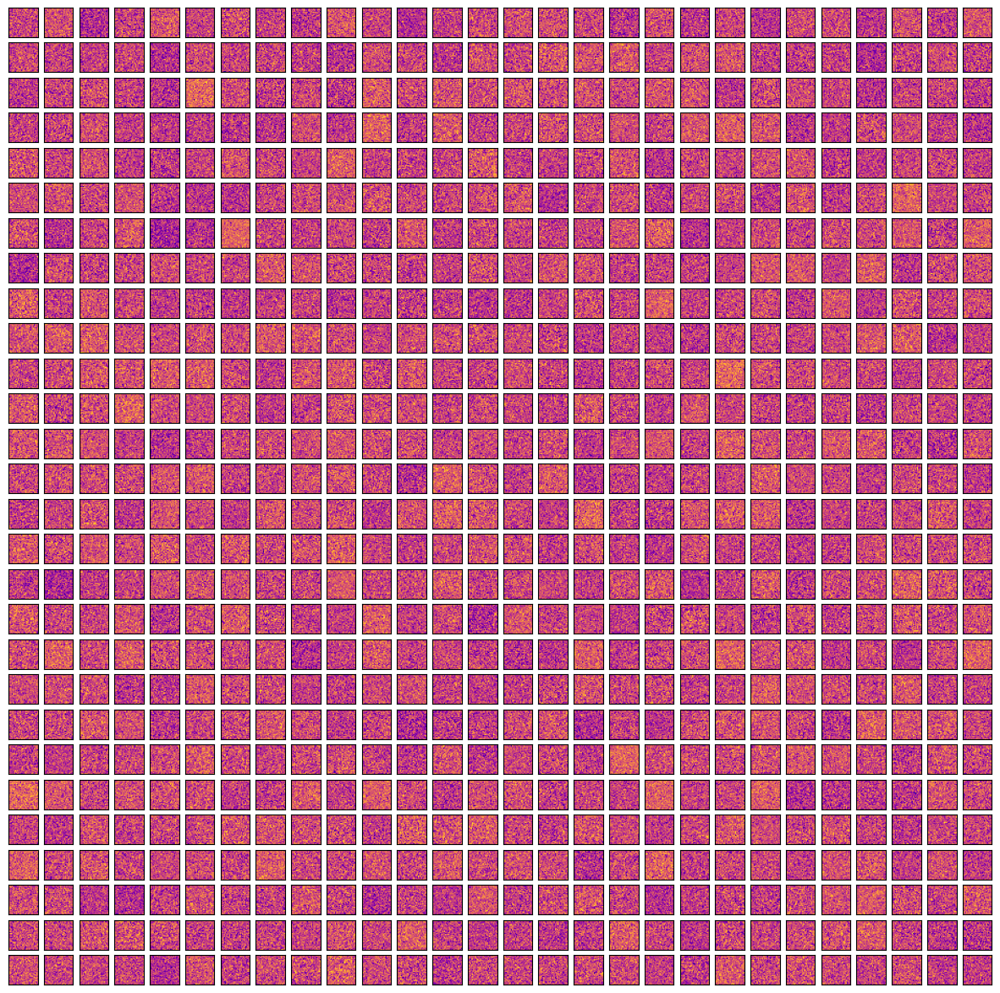


Halfway Through



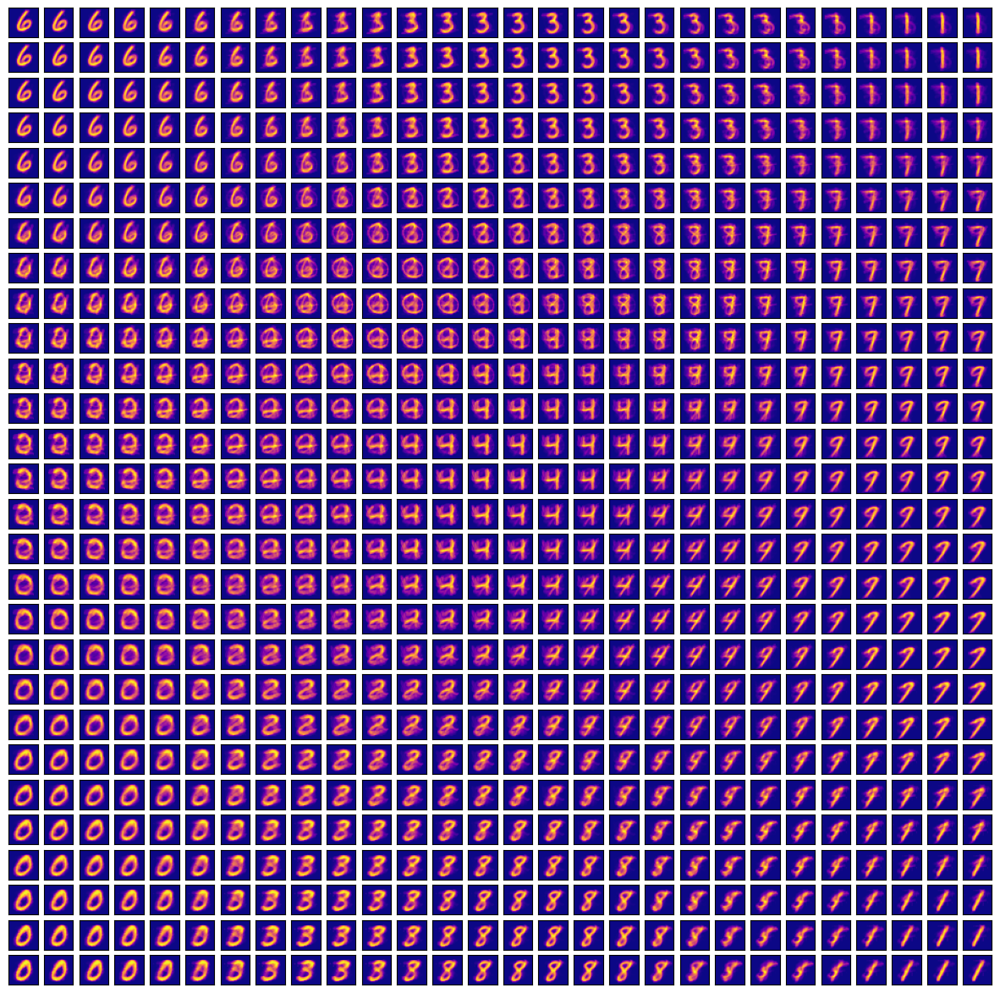


at the End



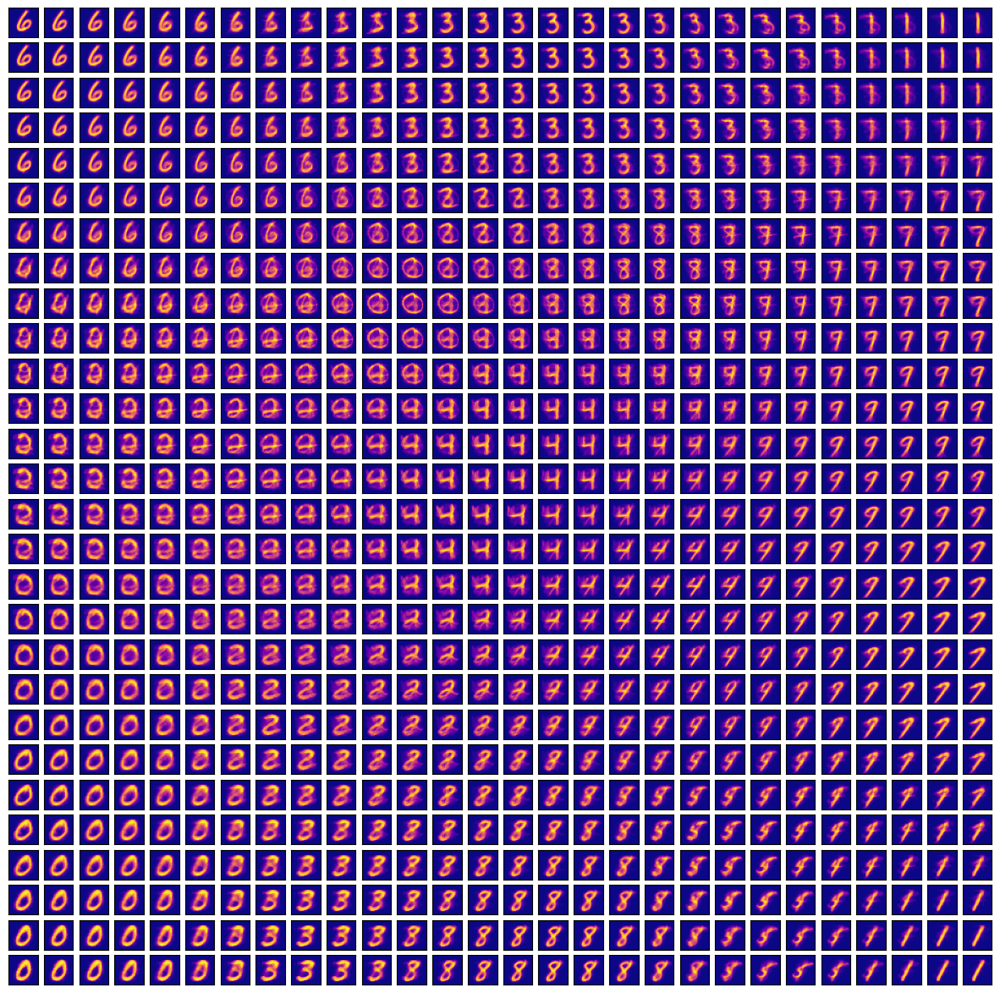


SOM features AFTER training: 

[[[ 4.05154143e-20  4.88140360e-20  1.02740234e-20 ...  2.30794816e-20
   -1.02679939e-19  3.57958632e-20]
  [ 2.02849510e-20 -3.57895717e-20  9.14259867e-21 ... -1.75142098e-20
    5.00481919e-20  1.30654375e-20]
  [ 7.82900110e-21 -1.92291698e-21  1.38288614e-20 ...  9.88535148e-21
   -1.22149183e-20 -8.49336313e-22]
  ...
  [-1.45250506e-23  5.03224610e-24 -7.55862774e-24 ... -3.33092332e-23
   -1.55568811e-23  2.13991726e-24]
  [-2.15683067e-23  7.13807727e-23  2.14415800e-23 ... -4.79820979e-24
    2.06518523e-23  2.99477978e-23]
  [ 1.15642275e-23 -1.20572522e-22 -2.91496334e-23 ...  8.73172550e-23
   -9.34158935e-23 -5.87877746e-23]]

 [[ 3.45877275e-20 -8.17546490e-21 -1.83269025e-20 ...  6.92197981e-21
    4.77962117e-20 -5.11732410e-21]
  [ 7.49188002e-21  1.86488315e-21 -1.04626135e-20 ...  7.02630704e-21
    3.47947949e-21 -3.90452475e-21]
  [ 3.44040675e-21  3.38653459e-21 -1.42750316e-21 ... -3.35625019e-21
   -2.07500686e-21  2.59544092e-2

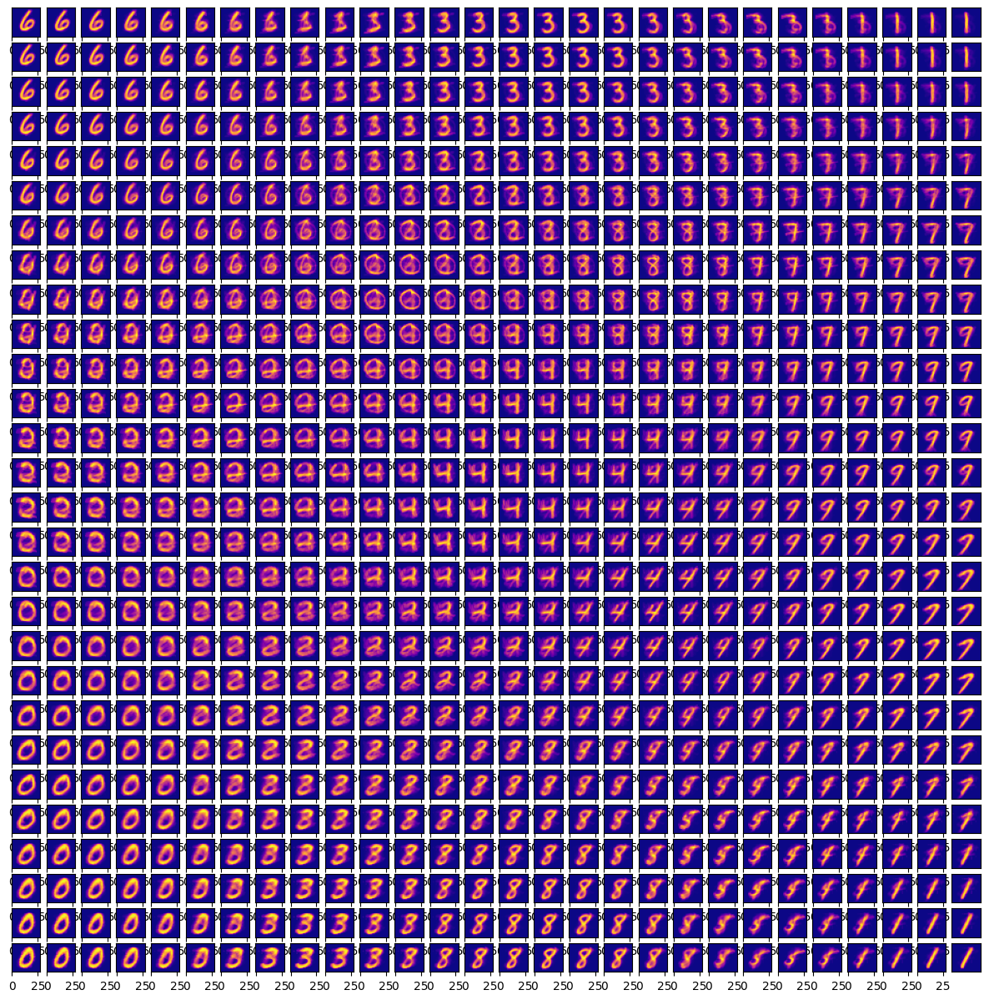

In [ ]:
#train SOM with grid 20x20, 40x40, 80x80 # grid_sizes = [20, 40, 80]
ndim20 = 20
som_trained_20x20 = SOM([28, 28], train_images_flattened, ndim=ndim20, nepochs=100, showMode=1)
print(som_trained_20x20)
plt.show()


SOM features before training: 


at the Beginning



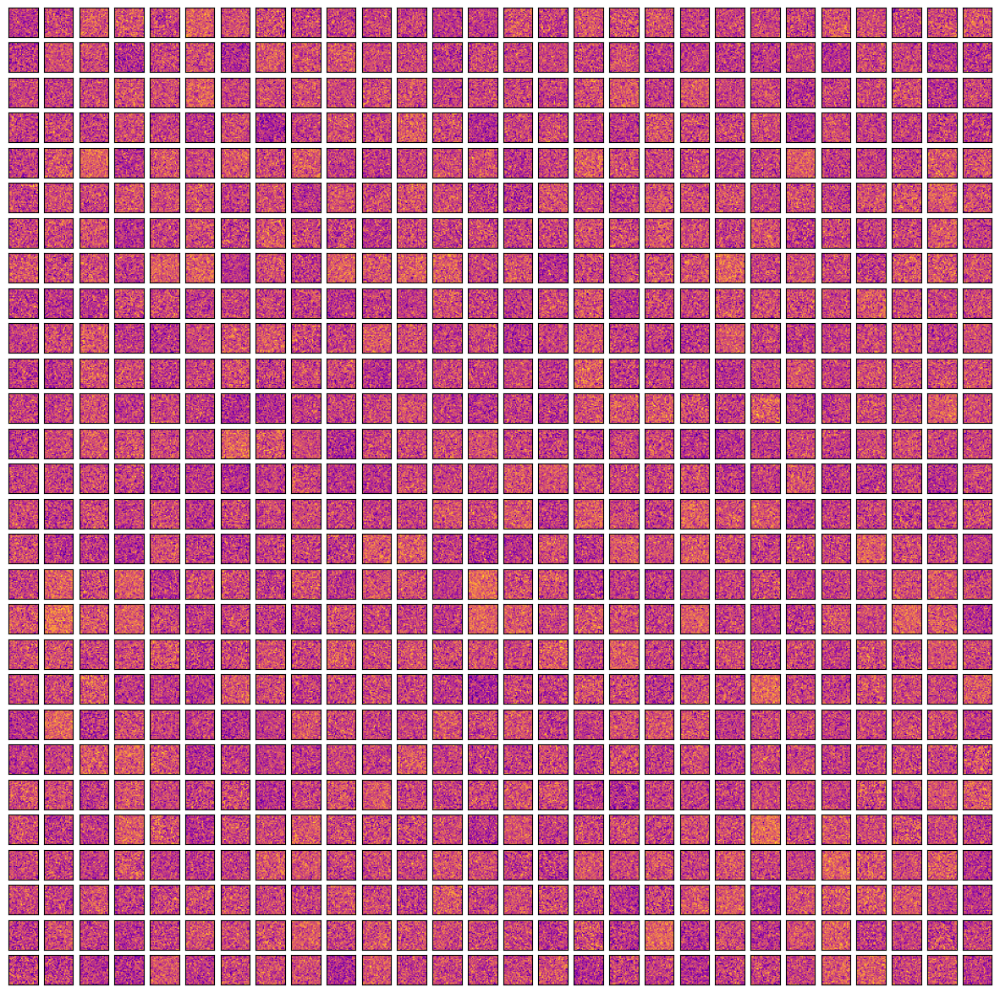

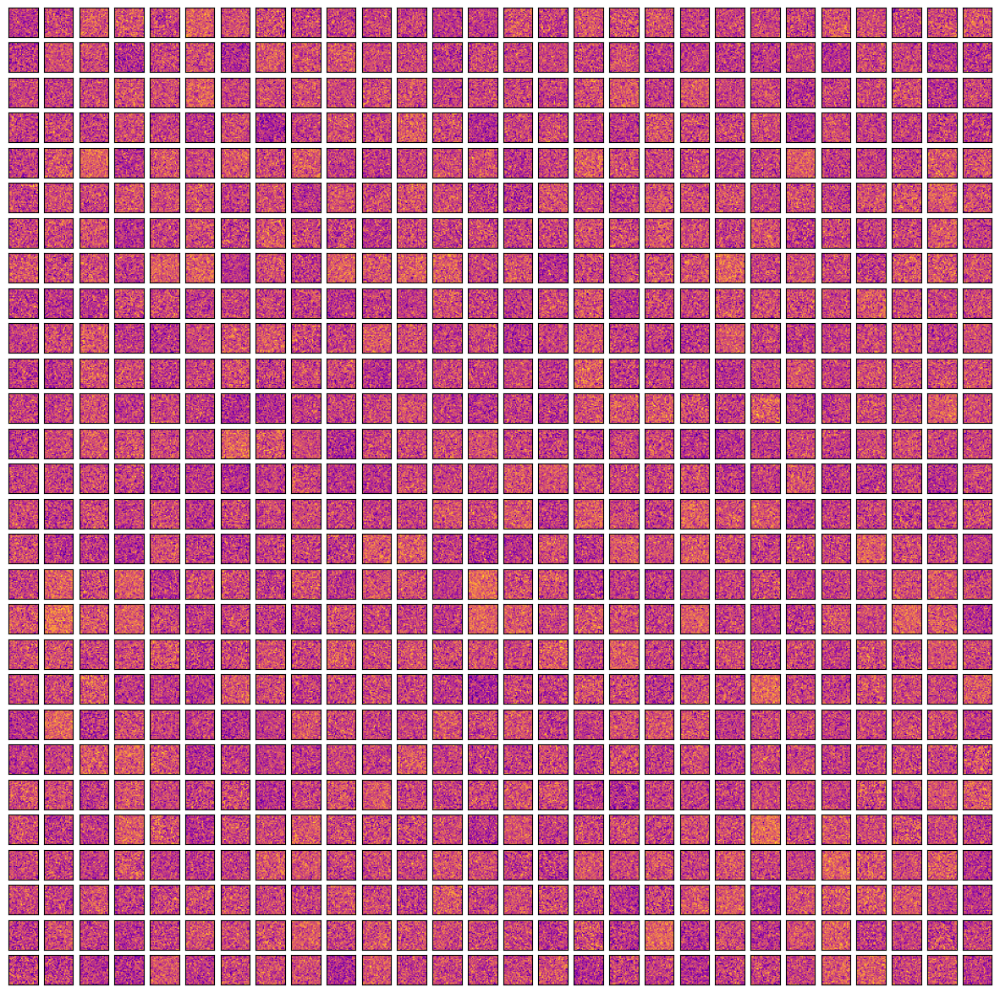


Halfway Through



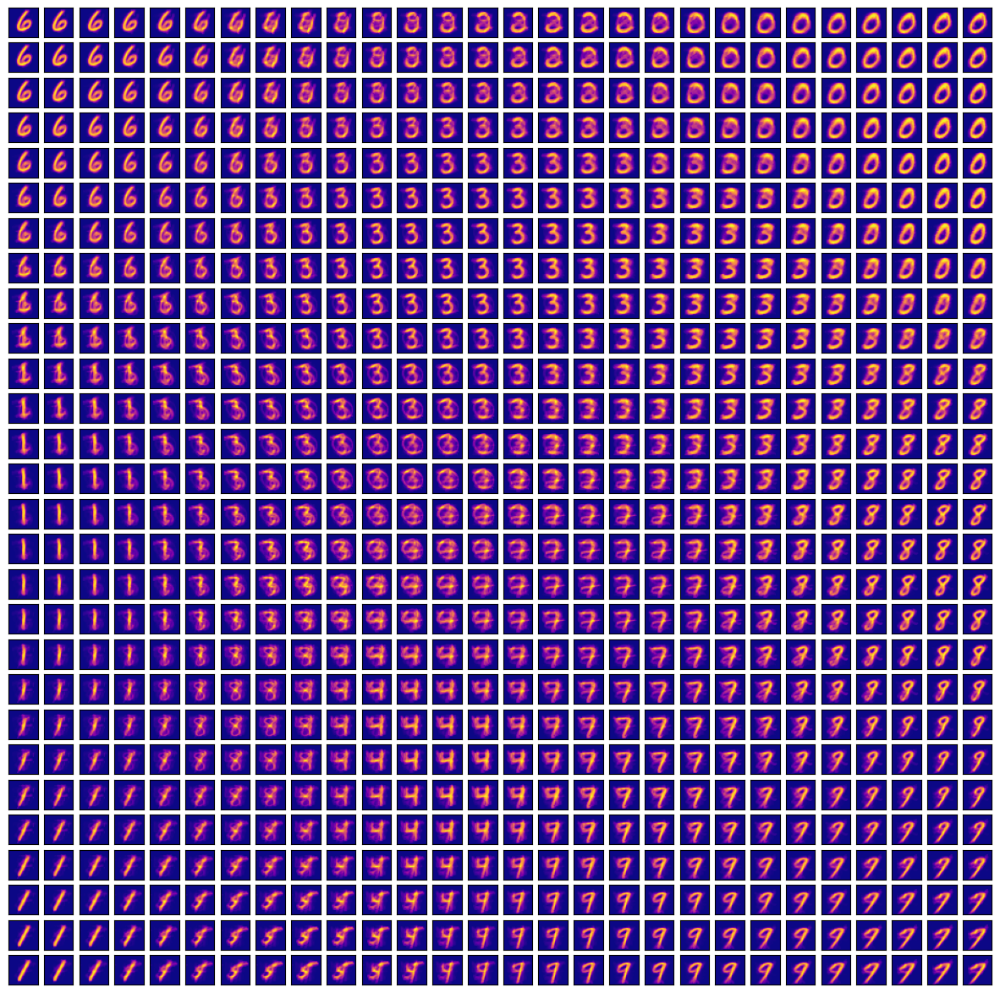


at the End



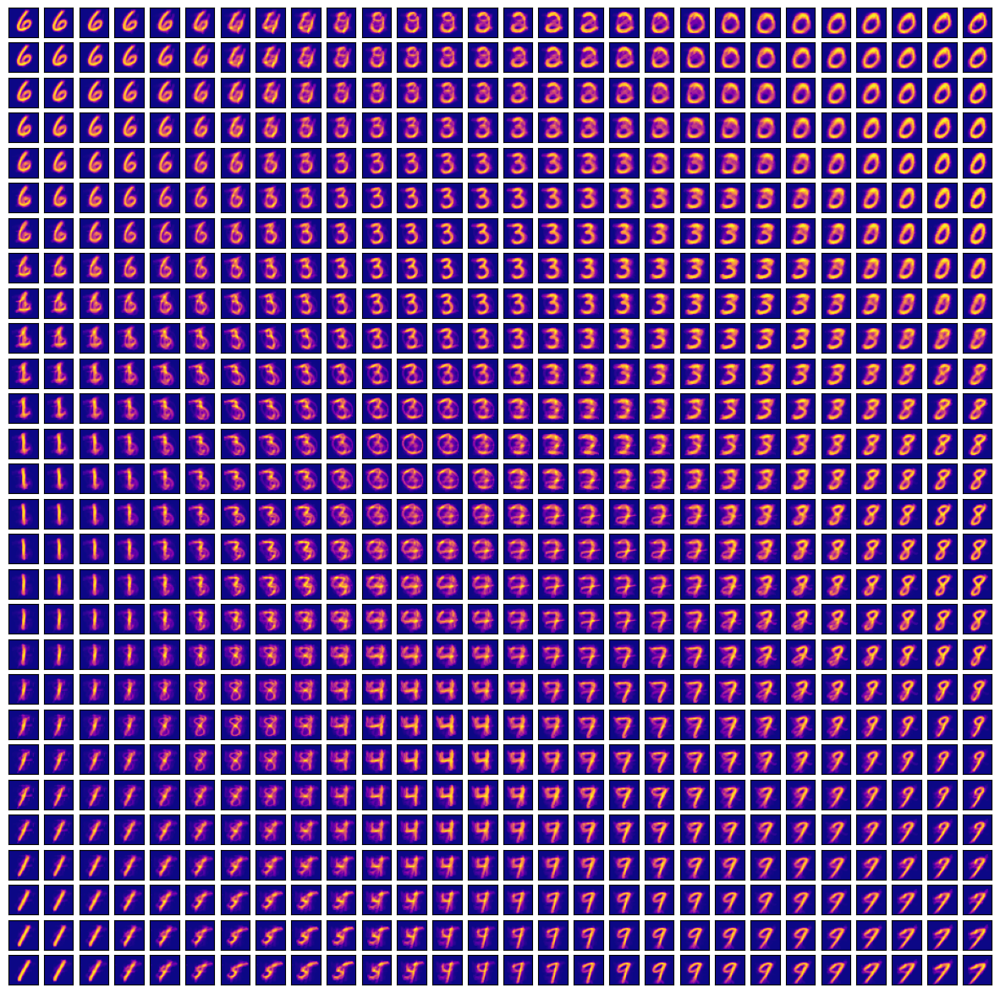


SOM features AFTER training: 

[[[ 4.21306471e-22  1.66469368e-22 -2.47346117e-22 ...  5.20209024e-22
    8.53286400e-22 -3.57011860e-22]
  [-2.25882083e-22  2.30435805e-22 -1.05324716e-25 ...  2.08909047e-22
    1.45110096e-22  9.25454985e-23]
  [-2.99191649e-22  1.43699547e-22  9.03269934e-23 ... -5.48975570e-23
   -4.90887592e-23  4.99934272e-23]
  ...
  [-2.55415412e-23 -4.67703522e-23  7.69722798e-23 ...  8.79685102e-23
   -1.98406010e-22 -5.41070969e-24]
  [-2.25331408e-22  5.41047653e-22  9.43213570e-23 ...  2.16188301e-22
    3.60035528e-22  4.24360946e-23]
  [ 6.94696050e-22 -3.55359984e-22 -6.25882276e-23 ... -1.83773203e-22
   -1.61976791e-22 -6.39834809e-23]]

 [[ 9.03171633e-24  9.21447395e-23  1.08876476e-22 ...  6.07187803e-23
    2.47656939e-22 -1.33134210e-22]
  [-9.26319009e-24  9.88045055e-24  4.16145170e-23 ... -3.23887963e-23
   -2.69369196e-23  1.34870439e-23]
  [-5.70782028e-24  6.13456162e-24  3.63489511e-23 ...  5.26415630e-23
   -3.68268951e-24  3.33788843e-2

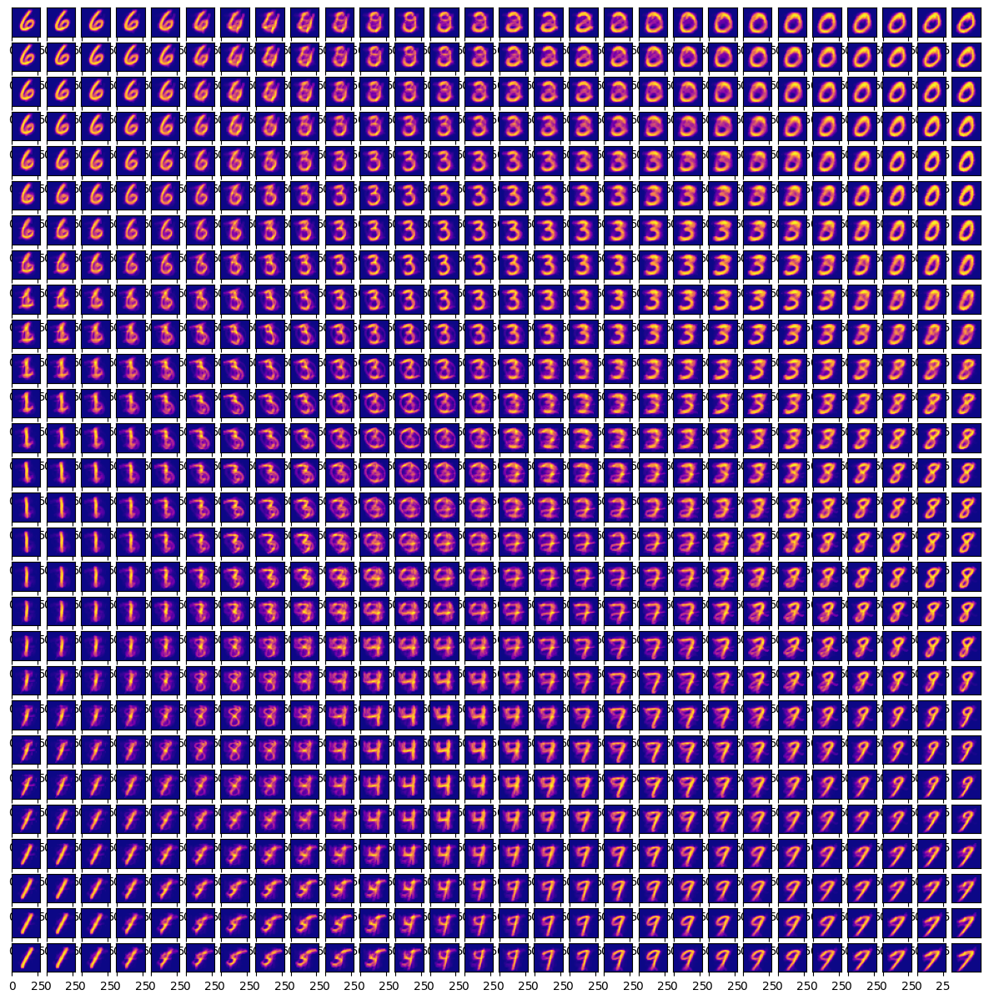

In [ ]:
ndim40 = 40
som_trained_40x40 = SOM([28, 28], train_images_flattened, ndim=ndim40, nepochs=100, showMode=1)
print(som_trained_40x40)
plt.show()


SOM features before training: 


at the Beginning



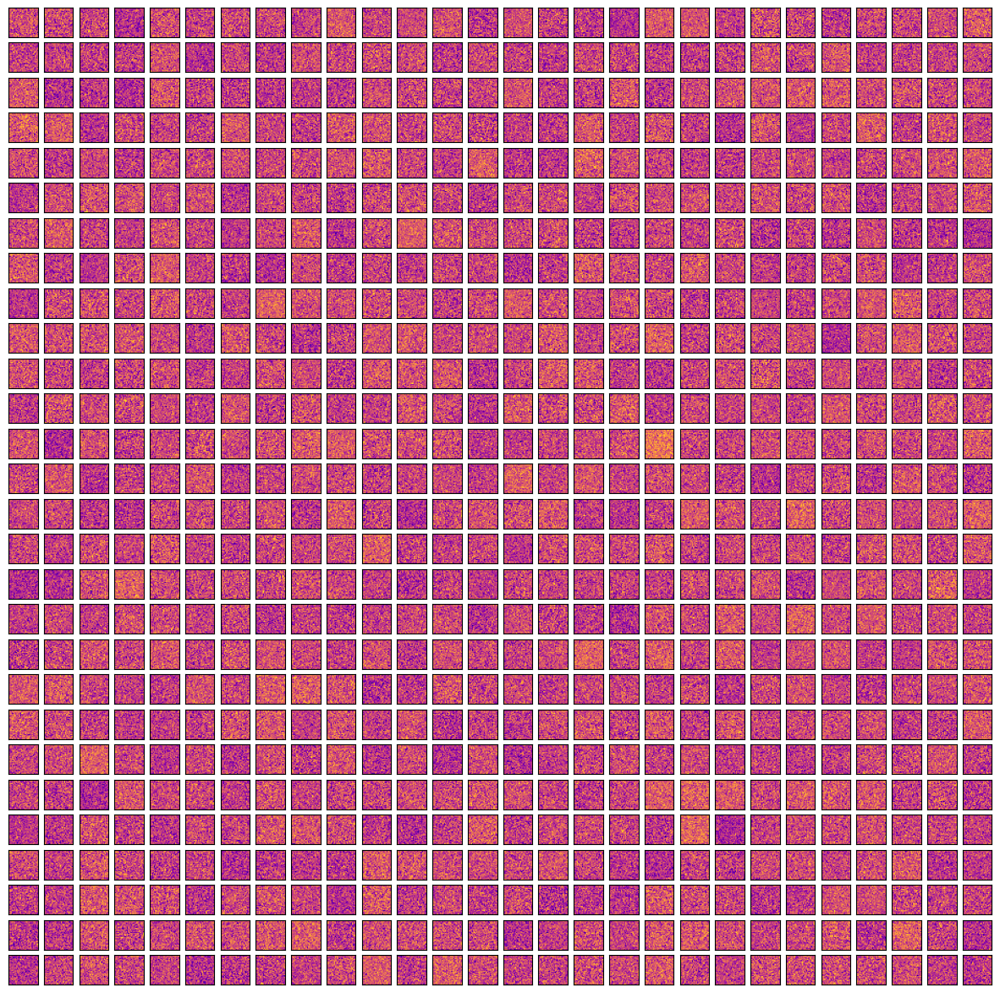

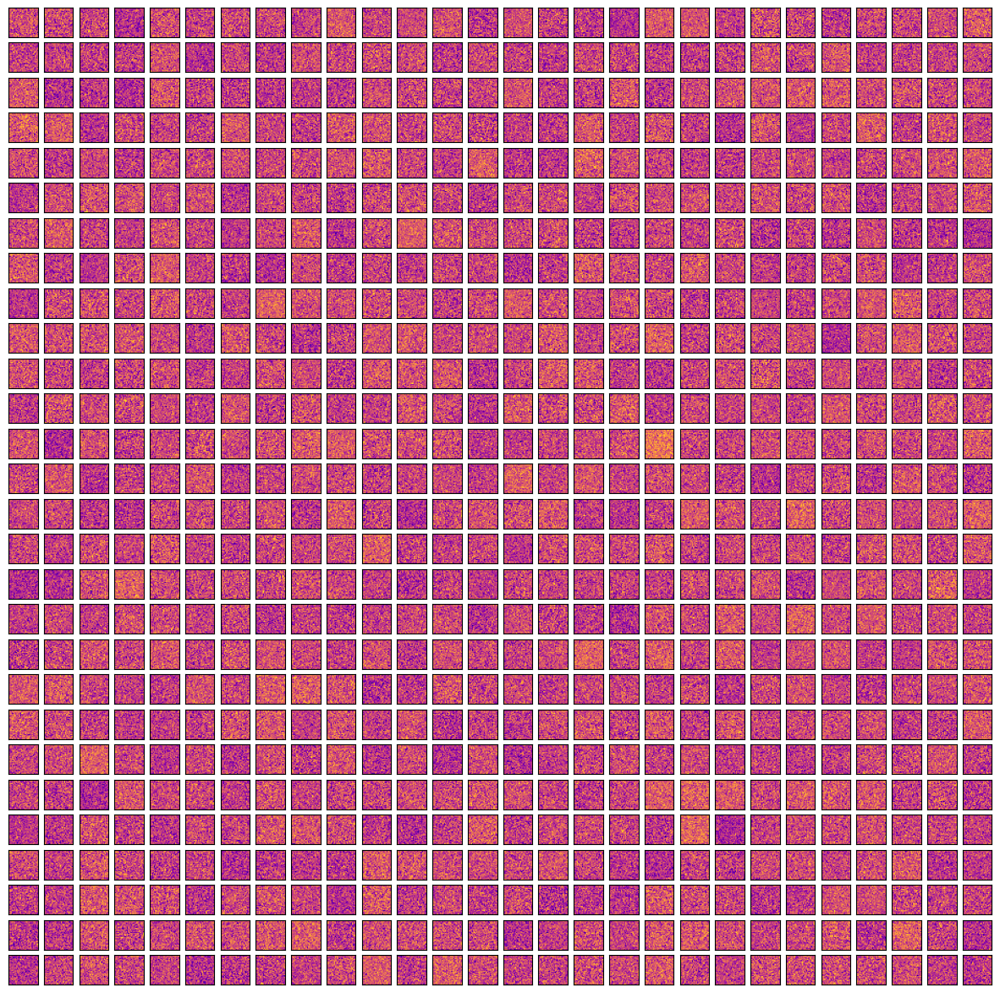


Halfway Through



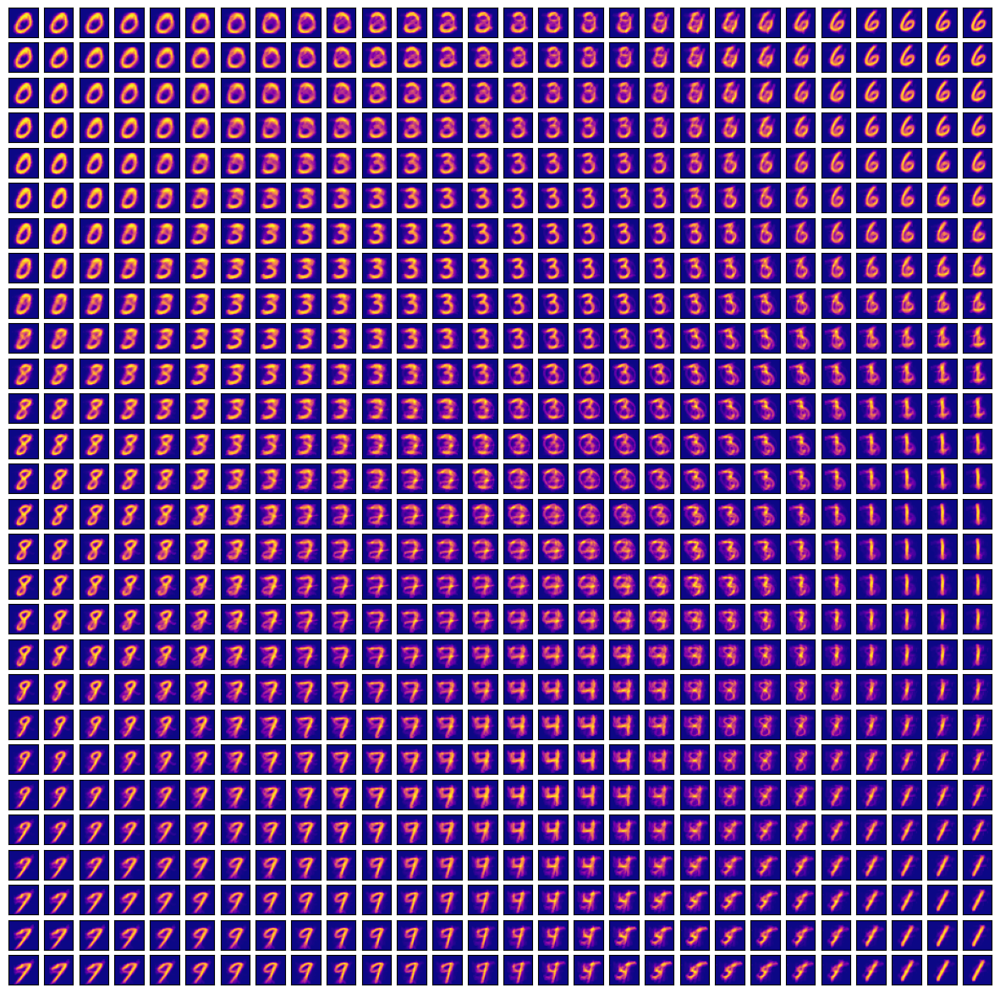


at the End



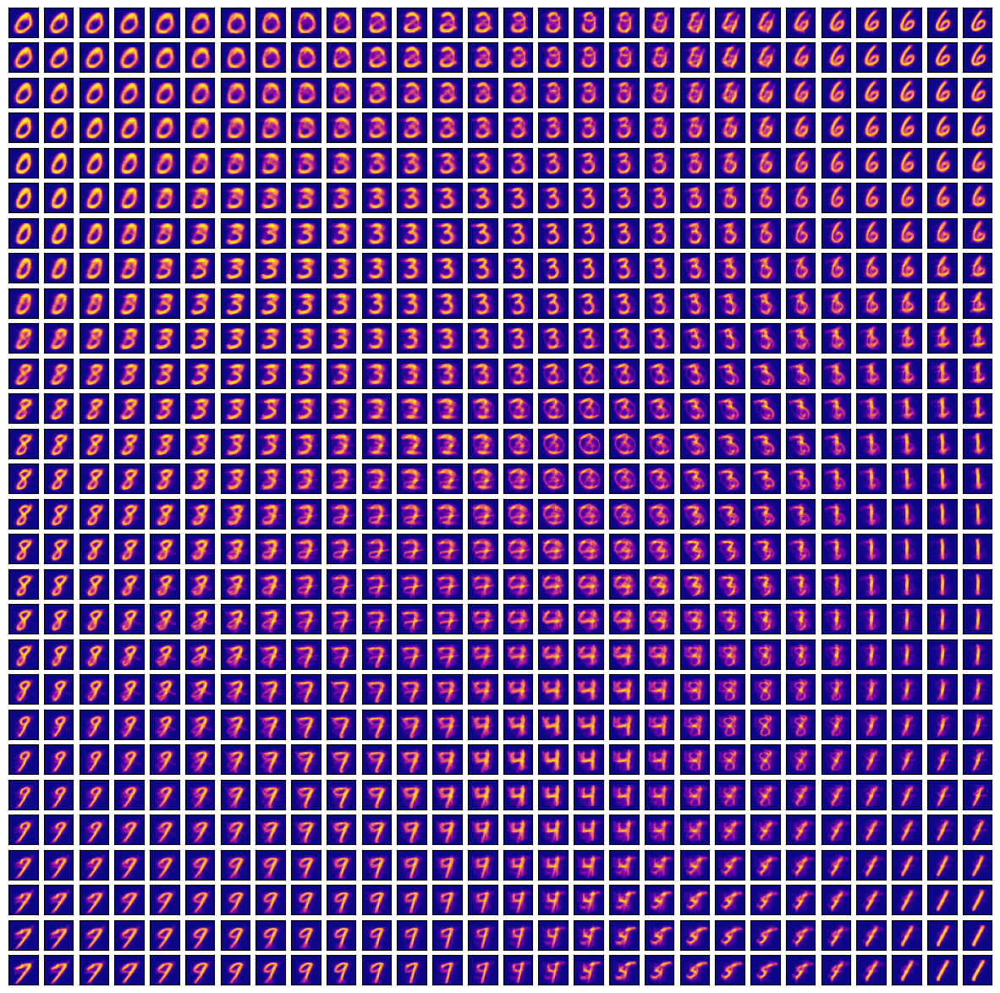


SOM features AFTER training: 

[[[-4.66160644e-23  9.82613183e-23  4.25582164e-22 ...  7.02403133e-22
    8.84257277e-22 -1.45253328e-22]
  [-4.76173699e-23 -8.98481299e-24 -1.01304020e-22 ...  4.53612513e-22
    2.50436593e-22 -3.33141723e-23]
  [-4.89653579e-23  8.85909715e-23  1.37110813e-22 ... -1.95781862e-23
   -3.21636001e-23  1.61714909e-22]
  ...
  [ 2.82611915e-23 -2.71699282e-23  1.75707964e-23 ...  6.96062154e-23
    1.29053948e-23  1.28395940e-23]
  [-8.11077995e-23  1.85116149e-23  4.40748020e-23 ... -1.51925326e-22
   -2.89765774e-23  2.29855784e-23]
  [-3.68935568e-22  2.45706541e-22  4.28101400e-22 ...  1.84871683e-23
   -1.48204632e-22  1.62160370e-22]]

 [[-4.09914970e-22  1.77480398e-22  3.98327662e-22 ... -1.52741801e-22
   -1.57443667e-22  4.42018813e-23]
  [-4.28612508e-23 -1.78082683e-23 -2.80438974e-23 ...  2.44350352e-24
    1.12019355e-22 -1.54598778e-23]
  [ 1.91991738e-23  1.20513177e-23 -3.70669929e-23 ...  4.58854590e-24
    2.83498656e-23  1.75766826e-2

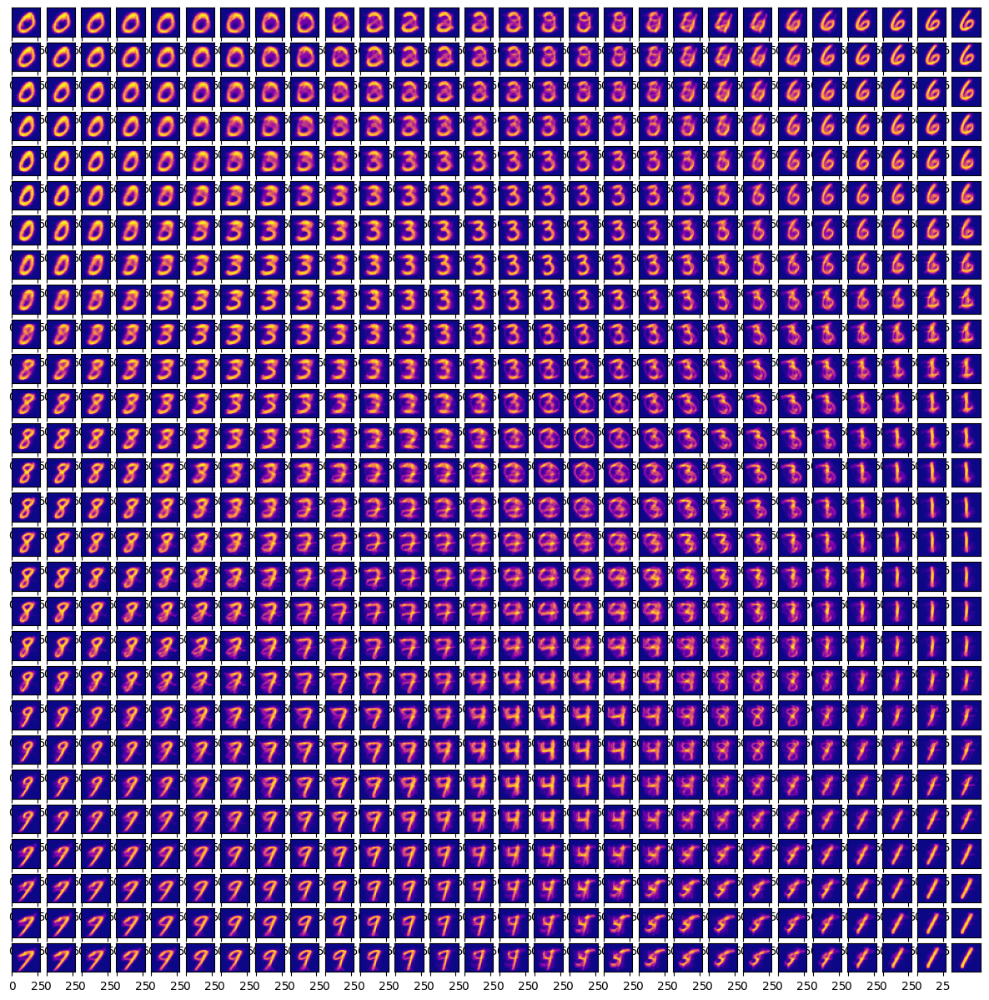

In [ ]:
ndim80 = 80
som_trained_80x80 = SOM([28, 28], train_images_flattened, ndim=ndim80, nepochs=100, showMode=1)
print(som_trained_80x80)
plt.show()

### 5: Display the confusion matrix of classification of the TRAINING SET and TEST SET

In [ ]:
#verification of correctness on the training set:
def SOM_Test (trainingData, som_, classes, grid_, ConfusionMatrix, ndim=60):
    nfeatures=trainingData.shape[1]
    ntrainingvectors=trainingData.shape[0]

    nrows = ndim
    ncols = ndim

    nclasses=np.max(classes)

    som_cl=np.zeros((ndim,ndim,nclasses+1))


    for ntraining in range(ntrainingvectors):
        trainingVector = trainingData[ntraining,:];
        class_of_sample= classes[ntraining]
        # Compute the Euclidean distance between the training vector and
        # each neuron in the SOM map
        dist = getEuclideanDistance(trainingVector, som_);

        # Find 2D coordinates of the Best Matching Unit (bmu)
        bmurow, bmucol =np.unravel_index(np.argmin(dist, axis=None), dist.shape) ;


        som_cl[bmurow, bmucol,class_of_sample]=som_cl[bmurow, bmucol,class_of_sample]+1



    for i in range (nrows):
        for j in range (ncols):
            grid_[i,j]=np.argmax(som_cl[i,j,:])


    for ntraining in range(ntrainingvectors):
        trainingVector = trainingData[ntraining,:];
        class_of_sample= classes[ntraining]
        # Compute the Euclidean distance between the training vector and
        # each neuron in the SOM map
        dist = getEuclideanDistance(trainingVector, som_);

        # Find 2D coordinates of the Best Matching Unit (bmu)
        bmurow, bmucol =np.unravel_index(np.argmin(dist, axis=None), dist.shape) ;

        predicted=np.argmax(som_cl[bmurow, bmucol,:])
        ConfusionMatrix[class_of_sample-1, predicted-1]=ConfusionMatrix[class_of_sample-1, predicted-1]+1

    return grid_, ConfusionMatrix

In [ ]:
def get_confusion_matrix(train_images, SOM, ndim=20):
    nrows=ndim
    ncols=ndim
    grid_color=np.zeros((nrows,ncols))
    nclasses=np.max(classes)

    confusion_matrix=np.zeros((nclasses,nclasses))
    grid_color,confusion_matrix=SOM_Test (train_images, SOM, classes, grid_color, confusion_matrix, ndim)

    plt.close()
    plt.imshow(grid_color)
    plt.show()

    return confusion_matrix, train_images_flattened.shape, np.sum(confusion_matrix)

In [ ]:
def calulate_accuracy(confusion_matrix):
    true_positives = np.trace(confusion_matrix)
    total_samples = np.sum(confusion_matrix)
    accuracy = true_positives / total_samples

    print("Accuracy:", accuracy)

Training Set


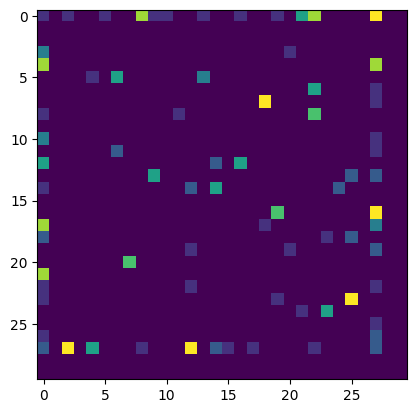

[[38.  2.  0.  0.  0.  0.  1.]
 [ 3. 16.  0.  0.  0.  0.  0.]
 [ 1.  0.  4.  0.  0.  0.  0.]
 [ 3.  0.  0.  9.  0.  0.  1.]
 [ 1.  0.  0.  0.  3.  0.  0.]
 [ 1.  0.  0.  0.  0.  6.  1.]
 [ 2.  1.  0.  0.  0.  0.  7.]]
Accuracy: 0.83
Test Set


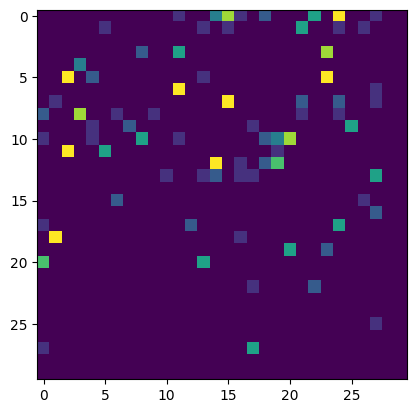

[[39.  0.  1.  0.  0.  0.  1.]
 [ 4. 15.  0.  0.  0.  0.  0.]
 [ 1.  0.  4.  0.  0.  0.  0.]
 [ 1.  0.  1. 11.  0.  0.  0.]
 [ 1.  1.  0.  0.  2.  0.  0.]
 [ 2.  1.  0.  1.  0.  4.  0.]
 [ 1.  0.  0.  0.  0.  0.  9.]]


In [ ]:
print("Training Set")
confusion_matrix, shape, sum_matrix = get_confusion_matrix(train_images_flattened, som_trained_20x20, 30)
print(confusion_matrix)
calulate_accuracy(confusion_matrix)

print("Test Set")
confusion_matrix, shape, sum_matrix = get_confusion_matrix(test_images_flattened, som_trained_20x20, 30)
print(confusion_matrix)

Training Set


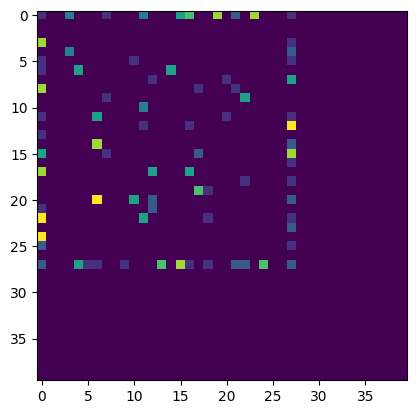

[[40.  1.  0.  0.  0.  0.  0.]
 [ 4. 15.  0.  0.  0.  0.  0.]
 [ 0.  1.  4.  0.  0.  0.  0.]
 [ 1.  0.  0. 12.  0.  0.  0.]
 [ 0.  0.  0.  0.  4.  0.  0.]
 [ 0.  0.  0.  0.  0.  8.  0.]
 [ 2.  1.  0.  1.  1.  1.  4.]]
Accuracy: 0.87
Test Set


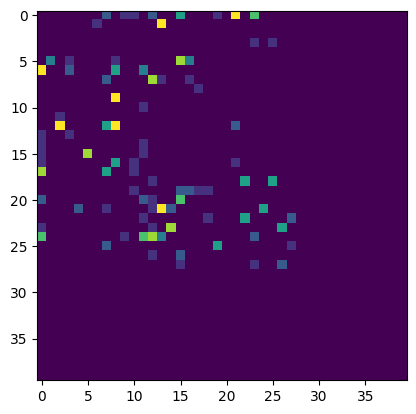

[[41.  0.  0.  0.  0.  0.  0.]
 [ 2. 17.  0.  0.  0.  0.  0.]
 [ 1.  0.  4.  0.  0.  0.  0.]
 [ 1.  1.  0. 11.  0.  0.  0.]
 [ 0.  0.  0.  0.  4.  0.  0.]
 [ 1.  0.  0.  0.  0.  7.  0.]
 [ 1.  0.  0.  1.  0.  1.  7.]]


In [ ]:
print("Training Set")
confusion_matrix, shape, sum_matrix = get_confusion_matrix(train_images_flattened, som_trained_40x40, ndim40)
print(confusion_matrix)
calulate_accuracy(confusion_matrix)

print("Test Set")
confusion_matrix, shape, sum_matrix = get_confusion_matrix(test_images_flattened, som_trained_40x40, ndim40)
print(confusion_matrix)

Training Set


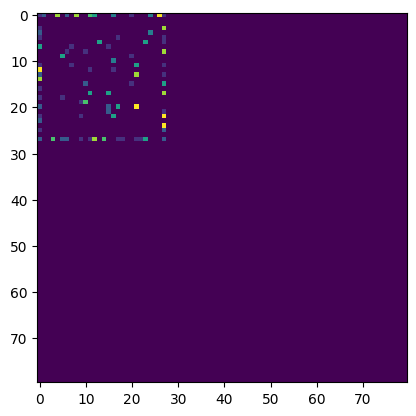

[[40.  1.  0.  0.  0.  0.  0.]
 [ 3. 16.  0.  0.  0.  0.  0.]
 [ 0.  1.  4.  0.  0.  0.  0.]
 [ 1.  0.  0. 12.  0.  0.  0.]
 [ 0.  0.  0.  0.  4.  0.  0.]
 [ 0.  0.  0.  0.  0.  8.  0.]
 [ 1.  1.  0.  1.  1.  1.  5.]]
Accuracy: 0.89
Test Set


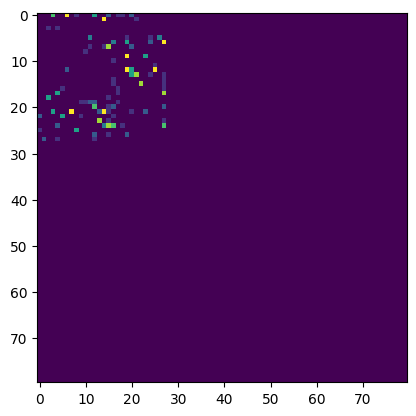

[[41.  0.  0.  0.  0.  0.  0.]
 [ 2. 17.  0.  0.  0.  0.  0.]
 [ 1.  0.  4.  0.  0.  0.  0.]
 [ 1.  2.  0. 10.  0.  0.  0.]
 [ 0.  0.  0.  0.  4.  0.  0.]
 [ 1.  0.  0.  0.  0.  7.  0.]
 [ 1.  0.  0.  0.  0.  1.  8.]]


In [ ]:
print("Training Set")
confusion_matrix, shape, sum_matrix = get_confusion_matrix(train_images_flattened, som_trained_80x80, ndim80)
print(confusion_matrix)
calulate_accuracy(confusion_matrix)

print("Test Set")
confusion_matrix, shape, sum_matrix = get_confusion_matrix(test_images_flattened, som_trained_80x80, ndim80)
print(confusion_matrix)

### 6: What is the resulting effect of changing learning rate with a fixed number of itterations

**ANSWER:** The accuracy increases consistently up to a learning rate of 0.75, after which it begins to decline. It appears that a learning rate of 0.6, as well as values above 0.8, result in the highest accuracy. The accuracy plateaus at around 91%.


--- Training with learning rate: 0.01 ---


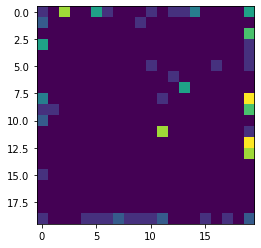

[[37.  3.  0.  1.  0.  0.  0.]
 [ 8.  9.  0.  2.  0.  0.  0.]
 [ 3.  0.  2.  0.  0.  0.  0.]
 [ 5.  2.  0.  6.  0.  0.  0.]
 [ 1.  0.  0.  1.  2.  0.  0.]
 [ 4.  0.  0.  1.  0.  3.  0.]
 [ 3.  4.  0.  0.  0.  1.  2.]]
Accuracy: 0.61

--- Training with learning rate: 0.1 ---


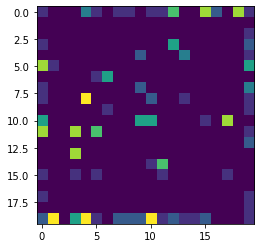

[[40.  1.  0.  0.  0.  0.  0.]
 [ 4. 15.  0.  0.  0.  0.  0.]
 [ 1.  1.  3.  0.  0.  0.  0.]
 [ 5.  1.  0.  7.  0.  0.  0.]
 [ 0.  0.  0.  1.  3.  0.  0.]
 [ 1.  0.  0.  0.  0.  7.  0.]
 [ 1.  3.  0.  1.  0.  1.  4.]]
Accuracy: 0.79

--- Training with learning rate: 0.25 ---


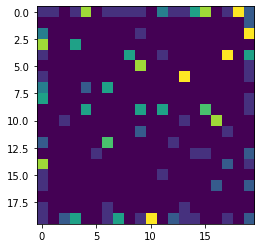

[[40.  1.  0.  0.  0.  0.  0.]
 [ 4. 15.  0.  0.  0.  0.  0.]
 [ 1.  1.  3.  0.  0.  0.  0.]
 [ 2.  0.  0. 11.  0.  0.  0.]
 [ 2.  0.  0.  0.  2.  0.  0.]
 [ 0.  2.  0.  0.  0.  6.  0.]
 [ 2.  1.  0.  1.  0.  1.  5.]]
Accuracy: 0.82

--- Training with learning rate: 0.5 ---


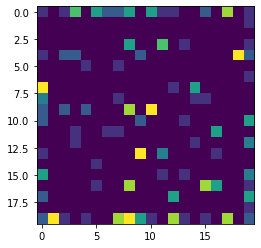

[[40.  1.  0.  0.  0.  0.  0.]
 [ 2. 17.  0.  0.  0.  0.  0.]
 [ 0.  1.  4.  0.  0.  0.  0.]
 [ 1.  0.  0. 12.  0.  0.  0.]
 [ 1.  0.  0.  1.  2.  0.  0.]
 [ 0.  1.  0.  0.  0.  7.  0.]
 [ 0.  2.  0.  1.  0.  1.  6.]]
Accuracy: 0.88

--- Training with learning rate: 0.75 ---


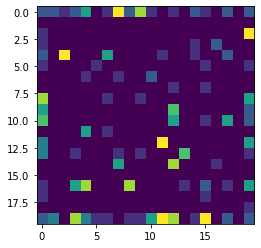

[[41.  0.  0.  0.  0.  0.  0.]
 [ 1. 18.  0.  0.  0.  0.  0.]
 [ 0.  1.  4.  0.  0.  0.  0.]
 [ 1.  0.  0. 12.  0.  0.  0.]
 [ 1.  0.  0.  0.  3.  0.  0.]
 [ 0.  1.  0.  0.  0.  7.  0.]
 [ 0.  3.  0.  1.  0.  0.  6.]]
Accuracy: 0.91

--- Training with learning rate: 0.85 ---


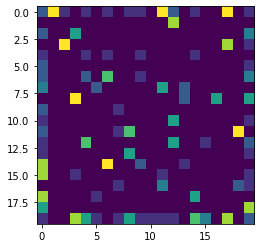

[[40.  1.  0.  0.  0.  0.  0.]
 [ 2. 17.  0.  0.  0.  0.  0.]
 [ 0.  0.  5.  0.  0.  0.  0.]
 [ 2.  0.  0. 11.  0.  0.  0.]
 [ 0.  0.  0.  0.  4.  0.  0.]
 [ 0.  0.  0.  0.  0.  8.  0.]
 [ 0.  1.  0.  1.  0.  1.  7.]]
Accuracy: 0.92

--- Training with learning rate: 0.95 ---


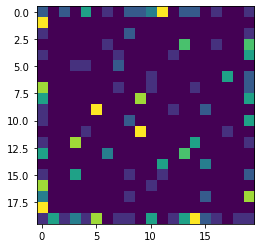

[[40.  1.  0.  0.  0.  0.  0.]
 [ 3. 16.  0.  0.  0.  0.  0.]
 [ 0.  0.  5.  0.  0.  0.  0.]
 [ 0.  0.  0. 13.  0.  0.  0.]
 [ 1.  0.  0.  0.  3.  0.  0.]
 [ 1.  1.  0.  0.  0.  6.  0.]
 [ 0.  1.  0.  2.  0.  1.  6.]]
Accuracy: 0.89


In [ ]:
learning_rates = [0.01, 0.1, 0.25, 0.5, 0.75, 0.85, 0.95]

for learning_rate in learning_rates:
    print(f"\n--- Training with learning rate: {learning_rate} ---")
    som = SOM([28, 28], train_images_flattened, ndim=ndim20, nepochs=100, eta0=learning_rate, etadecay=0.05, sgm0=20, sgmdecay=0.05, showMode=0)
    confusion_matrix, shape, sum_matrix = get_confusion_matrix(train_images_flattened, som, ndim20)
    print(confusion_matrix)
    calulate_accuracy(confusion_matrix)

### 7: For a fixed number of iterations and the best learning rate increase and decrease the exponential decay of the neighbourhood parameter.
### 8. What is the effect?

**ANSWER:** The accuracy demonstrates an upward trend, at least up to a learning rate of 0.5. Beyond this point, the accuracy plateaus, and there is an exponential decay observed with a value of 0.2. Any learning rate higher than 0.2 consistently produces an accuracy of 99%.

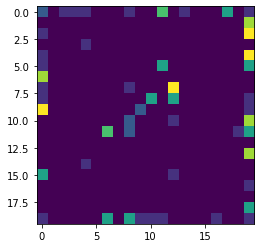

[[38.  3.  0.  0.  0.  0.  0.]
 [10.  9.  0.  0.  0.  0.  0.]
 [ 4.  1.  0.  0.  0.  0.  0.]
 [ 2.  0.  0. 11.  0.  0.  0.]
 [ 1.  1.  0.  0.  2.  0.  0.]
 [ 3.  0.  0.  0.  1.  4.  0.]
 [ 5.  1.  0.  0.  0.  0.  4.]]
Accuracy: 0.68


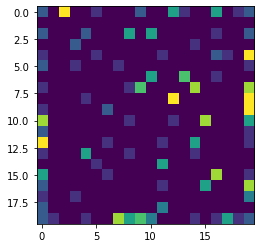

[[41.  0.  0.  0.  0.  0.  0.]
 [ 2. 17.  0.  0.  0.  0.  0.]
 [ 1.  1.  3.  0.  0.  0.  0.]
 [ 0.  0.  0. 13.  0.  0.  0.]
 [ 1.  0.  0.  0.  3.  0.  0.]
 [ 0.  1.  0.  0.  0.  7.  0.]
 [ 1.  3.  0.  0.  0.  0.  6.]]
Accuracy: 0.9


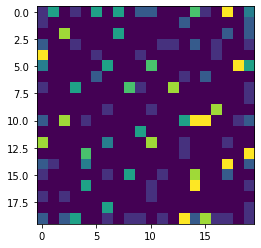

[[41.  0.  0.  0.  0.  0.  0.]
 [ 1. 18.  0.  0.  0.  0.  0.]
 [ 1.  0.  4.  0.  0.  0.  0.]
 [ 0.  0.  0. 13.  0.  0.  0.]
 [ 0.  0.  0.  0.  4.  0.  0.]
 [ 0.  0.  0.  0.  0.  8.  0.]
 [ 0.  1.  0.  0.  0.  0.  9.]]
Accuracy: 0.97


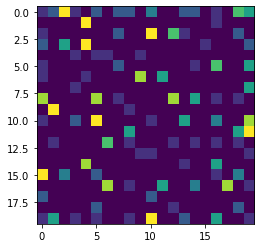

[[41.  0.  0.  0.  0.  0.  0.]
 [ 1. 18.  0.  0.  0.  0.  0.]
 [ 0.  0.  5.  0.  0.  0.  0.]
 [ 0.  0.  0. 13.  0.  0.  0.]
 [ 0.  0.  0.  0.  4.  0.  0.]
 [ 0.  0.  0.  0.  0.  8.  0.]
 [ 0.  0.  0.  0.  0.  0. 10.]]
Accuracy: 0.99


In [ ]:
decay_values = [0.01, 0.05, 0.1, 0.5]
for decay_value in decay_values:
    som = SOM([28, 28], train_images_flattened, ndim=20, nepochs=100, eta0=0.75, etadecay=0.05, sgm0=20, sgmdecay=decay_value, showMode=0)

    confusion_matrix, shape, sum_matrix = get_confusion_matrix(train_images_flattened, som, ndim20)
    print(confusion_matrix)
    calulate_accuracy(confusion_matrix)

### 9: What is a biological neuron? How does it relate to the concept of neurons in SOM?

**ANSWER:** Biological neurons, integral components of the nervous system, facilitate the transmission of information through a combination of electrical and chemical signals. Structurally, they consist of dendrites (responsible for signal reception), a cell body (engaged in signal processing), and an axon (involved in signal transmission). These neurons intricately form networks to execute functions such as cognition and perception.

On the other hand, neurons within Self-Organizing Maps (SOMs) serve as simplified computational models. They function as data structures that dynamically adjust their weights through unsupervised learning, primarily influenced by input patterns. While drawing inspiration from the adaptability of biological neurons to stimuli, SOM neurons are inherently simpler in design and find application in tasks like pattern recognition. Notably, while biological neurons transmit binary "fire or not fire" signals, artificial neurons in SOMs transmit continuous values.